In [ ]:
from pathlib import Path
import torch

path = Path("/home/ka/ka_stud/ka_ulgrl/policies/Isaac-GR00T/collect_data/data/2025_07_17-17_14_34/Panda 10 follower/gripper_state.pt")

panda_gripper_state = torch.load(path)

print(panda_gripper_state)


tensor([ 1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,  1.,
         1.,  1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1.,
        -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1.,
        -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1.,
        -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1.,
        -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -1., -

/scratch/ipykernel_800673/2061832988.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  panda_gripper_state = torch.load(path)


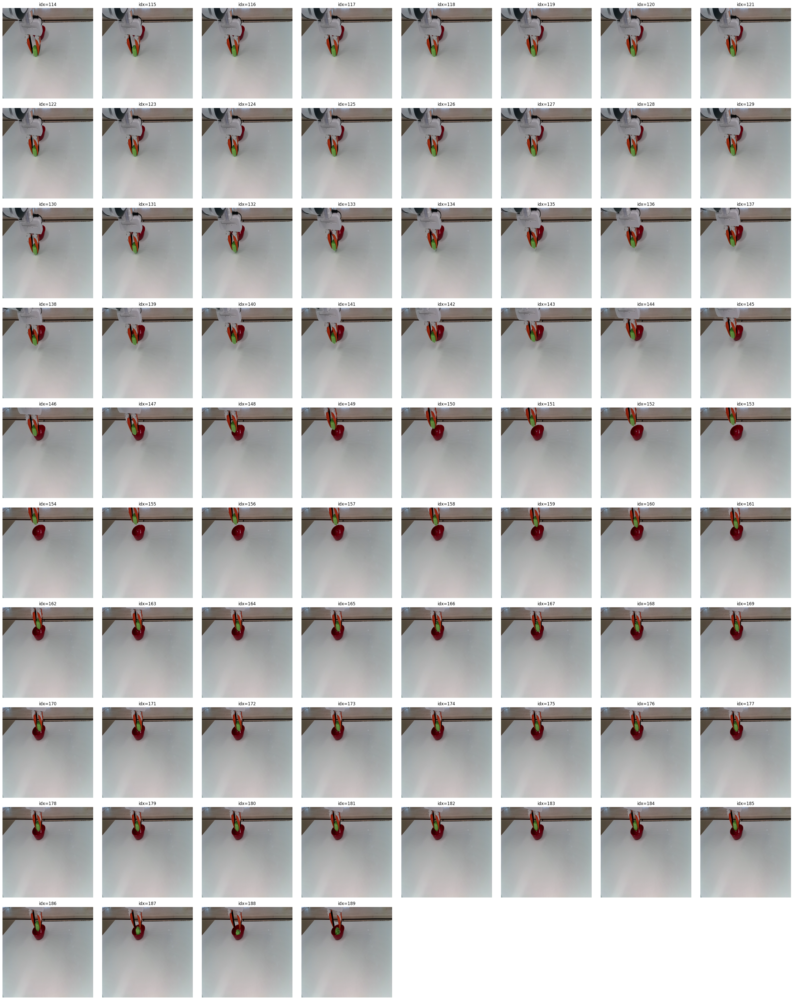

In [11]:
from pathlib import Path
import torch
from PIL import Image
import matplotlib.pyplot as plt
import math

# —— 1. 加载 gripper_state 并找出 -1 索引 —— 
pt_path = Path("/home/ka/ka_stud/ka_ulgrl/policies/Isaac-GR00T/collect_data/data/"
               "2025_07_17-17_14_34/Panda 10 follower/gripper_state.pt")
gripper_state = torch.load(pt_path, map_location="cpu", weights_only=True)
neg_indices = (gripper_state == -1).nonzero(as_tuple=True)[0].tolist()

# —— 2. 定位 side_cam 目录 —— 
episode_dir  = pt_path.parent.parent
side_cam_dir = episode_dir / "sensors" / "side_cam"

# —— 3. 计算网格行列数 —— 
n = len(neg_indices)
if n == 0:
    print("No frames with gripper_state == -1")
else:
    max_cols = 8
    cols = min(n, max_cols)
    rows = math.ceil(n / max_cols)

    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    axes = axes.flatten()

    # —— 4. 填充子图 —— 
    for ax, idx in zip(axes, neg_indices):
        img_path = side_cam_dir / f"{idx}.png"
        if img_path.exists():
            img = Image.open(img_path)
            ax.imshow(img)
            ax.set_title(f"idx={idx}")
        else:
            ax.set_title(f"idx={idx}\n(not found)")
        ax.axis("off")

    # —— 5. 其余子图隐藏 —— 
    for ax in axes[n:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()


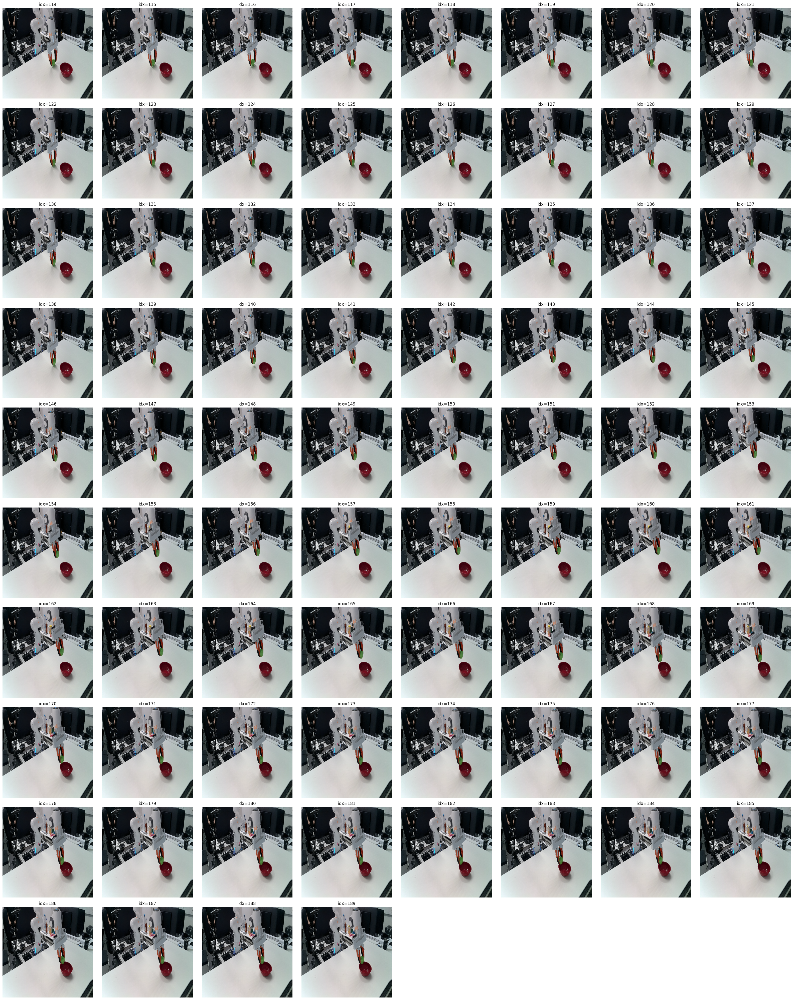

In [12]:
side_cam_dir = episode_dir / "sensors" / "top_cam"

# —— 3. 计算网格行列数 —— 
n = len(neg_indices)
if n == 0:
    print("No frames with gripper_state == -1")
else:
    max_cols = 8
    cols = min(n, max_cols)
    rows = math.ceil(n / max_cols)

    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    axes = axes.flatten()

    # —— 4. 填充子图 —— 
    for ax, idx in zip(axes, neg_indices):
        img_path = side_cam_dir / f"{idx}.png"
        if img_path.exists():
            img = Image.open(img_path)
            ax.imshow(img)
            ax.set_title(f"idx={idx}")
        else:
            ax.set_title(f"idx={idx}\n(not found)")
        ax.axis("off")

    # —— 5. 其余子图隐藏 —— 
    for ax in axes[n:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()